In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_theme(style="white")
sns.set_color_codes("pastel")

from sklearn.compose import ColumnTransformer, make_column_transformer
from sklearn.compose import make_column_selector as selector
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import MinMaxScaler, OneHotEncoder, OrdinalEncoder, StandardScaler, RobustScaler
from sklearn.feature_selection import SelectPercentile, f_classif, RFE, chi2, mutual_info_classif
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_predict, cross_val_score, cross_validate, learning_curve
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report, plot_confusion_matrix

from sklearn import set_config
set_config(display="diagram")

In [2]:
data = pd.read_csv( "fr-esr-parcoursup.csv",sep=";")

# Thématique :  <b>L'EDUCATION</b>

1. Nous avons pris pour thème l'éducation. Avec comme objectif global de créer une modélisation liée aux données remontées des établissements d'enseignement.

2. Nous avons initialement choisit un dataset témoignant de la réussite scolaire dans deux écoles portugaises. Nous avons fait le choix de ce dataset en fonction du fait qu'il avait un nombre conséquent de réutilisation sur kaggle.  
L'objectif était d'arriver à déterminer la note obtenue à l'issue de la dernère période scolaire en fonction de critères démographiques, socials et scolaires. 
Hélas nous nous sommes apperçus que les modélisations donnant des résultats probants nécessitaient de conserver deux 'features' extrêmement corrélées avec la 'target'. Il s'agit de la note moyenne de la première et de la seconde période scolaire. 
Nous avons donc consulté la sythèse de l'équipe de recherche à l'origine de ces données et cela nous a confortés dans notre conclusion quand à la non pertinence d'un modèle en utilisant les autres données.

3. Nous avons donc abandonné ce projet, et convenu de trouver une autre sources de données.

4. Notre choix s'est alors porté sur les données remontées de <b>Parcoursup</b>, pour l'année 2020.
[Lien vers les ressources parcoursup-2020.](https://www.data.gouv.fr/fr/datasets/parcoursup-2020-voeux-de-poursuite-detudes-et-de-reorientation-dans-lenseignement-superieur-et-reponses-des-etablissements/#_)




# Organisation
Lien du trello : https://trello.com/b/PXMmHUci/education  

Nous avons dédié deux usages à notre Trello pour ce projet :
- mutualiser les ressources.
- définir et suivre l'avancement (modèle : "Todo, doing, done").

Pour chaque carte nous avons défini une deadline pour nous aider à tenir les délais.

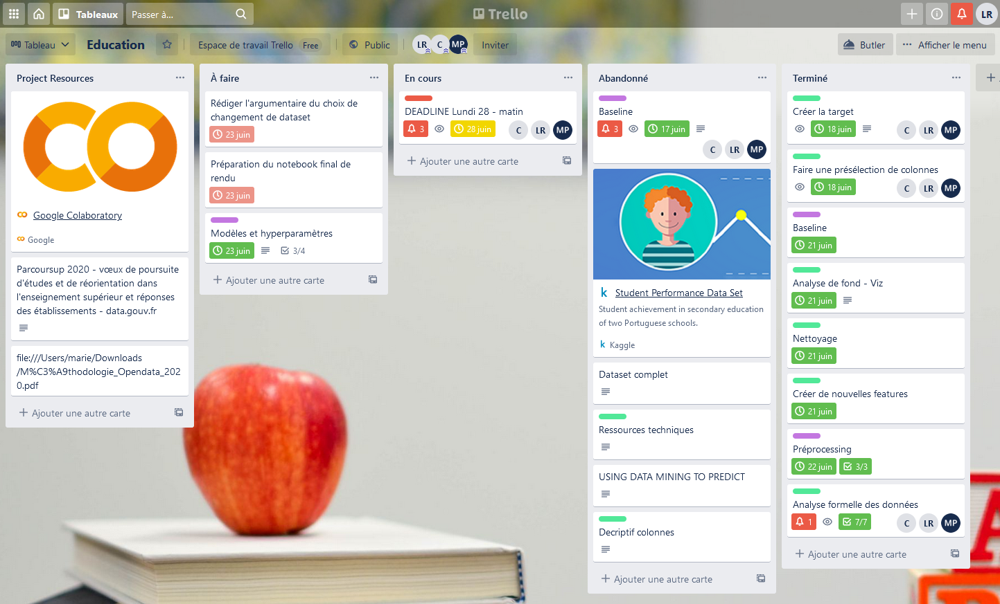

In [ ]:
from IPython.display import Image
Image('maps/trello.png')

# Description du dataset et de la problématique

**Parcours sup 2020** : 
- 114 variables
- 12760 enregistrements

**Features concernant la formation (15)** :
- Etablissement (nom, localisation)
- Type de formation (4 niveaux de détail différents)
- Formation sélective ou non // Privée ou publique
- Capacité d'accueil

**Features concernant les candidatures et le processus de sélection :**

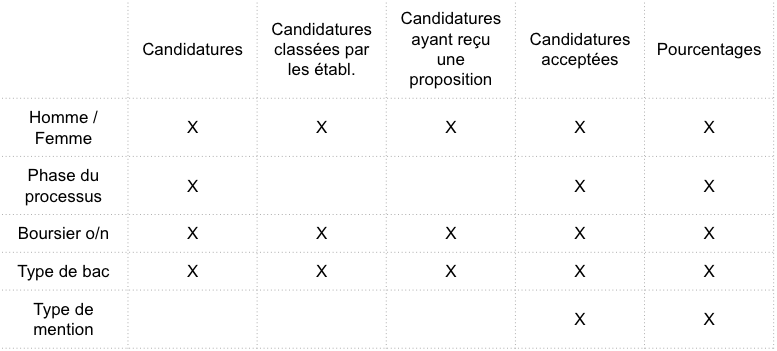

# Identification et analyse de la target

## Analyse de la Target
Objectif : prédire l'attractivité d'un établissement
- Attractivité mesurée par le nombre de candidatures
- 195 établissements ne comptabilisent aucune candidature (1,6% des observations). Ce sont essentiellement des formations allant de pair avec d'autres (classes passerelles...). Nous avons fait le choix de les conserver.
- beaucoup de valeurs extrêmes sont présentes sur la droite de la distribution. Ainsi le dernier quartile présente des valeurs allant de 900 à 16 000 candidats.

- Discrétisation de la target pour être plus pertinent : de 0 (pas attractif) à 4 (très attractif, plus de 2000 candidatures)



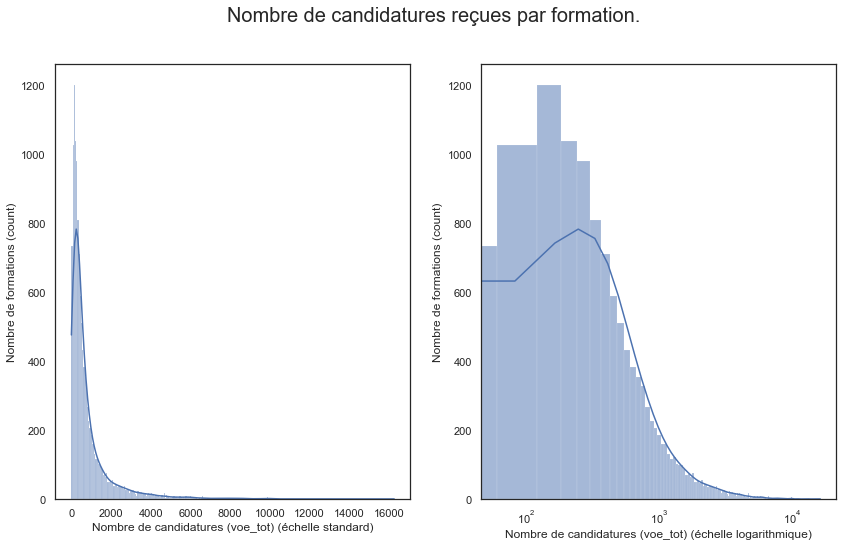

In [4]:
# CHOIX DE LA CIBLE : distribution des candidatures par formation.
df_main = pd.read_csv( "fr-esr-parcoursup.csv",sep=";")

fig,(ax1,ax2) = plt.subplots(1,2, figsize=(14,8))
# Histogramme 1
splot = sns.histplot(df_main['voe_tot'], kde=True, ax=ax1)
ax1.set_xlabel('Nombre de candidatures (voe_tot) (échelle standard)')
ax1.set_ylabel('Nombre de formations (count)')
# Histogramme 2
splotlog = sns.histplot(df_main['voe_tot'], kde=True, ax=ax2)
splotlog.set(xscale="log")
ax2.set_xlabel("Nombre de candidatures (voe_tot) (échelle logarithmique)")
ax2.set_ylabel('Nombre de formations (count)')
fig.suptitle('Nombre de candidatures reçues par formation.', fontsize=20);

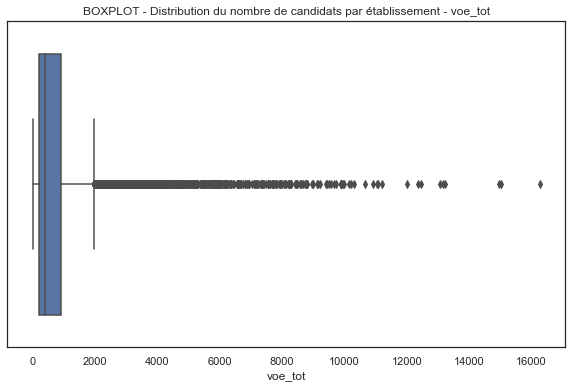

In [5]:
plt.figure(figsize=(10,6))
plt.title("BOXPLOT - Distribution du nombre de candidats par établissement - voe_tot")
plt.xlabel("distribution de voe_tot")
sns.boxplot(x=data["voe_tot"]);

## Target discrétisée

In [6]:
data['target']=data['voe_tot'].apply(lambda x: 0 if x < 200 else (1 if 200 <= x < 400 else (2 if 400 <= x < 900 else (3 if 900 <= x < 2000 else 4 ))))

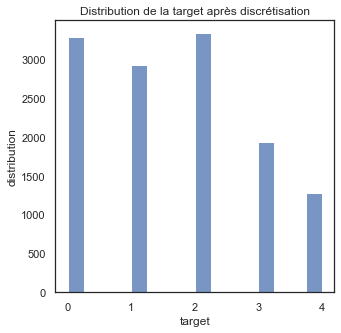

In [7]:
# on observe maintenant la répartition de notre target
plt.figure(figsize=(5, 5))
plt.title("Distribution de la target après discrétisation")
plt.ylabel("distribution")
plt.xlabel("target")
sns.histplot(data["target"]);

# Analyse visuelle des données

## Vue d'ensemble 

In [8]:
filiere = data.groupby(by="fili").sum()
filiere = filiere.sort_values(by="voe_tot", ascending=False)

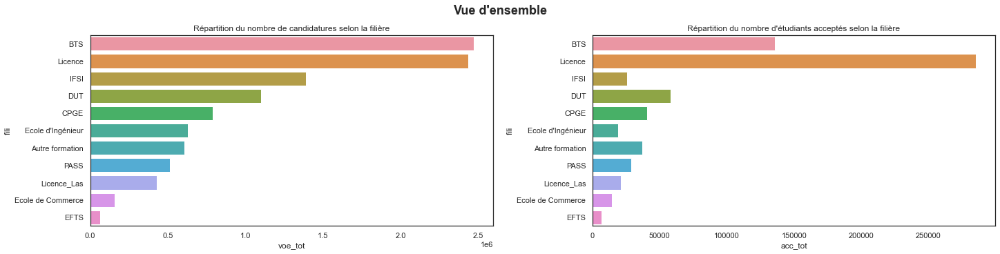

In [9]:
#@title
# nombre de candidatures par filière
#df = df.sort_values(by="acc_tot", ascending=False)
fig, (axe1, axe2) = plt.subplots(nrows=1,ncols=2, figsize=(20,5), constrained_layout=True)

fig.suptitle('''Vue d'ensemble''', fontsize=18,fontweight="extra bold")

sns.barplot(x="voe_tot", y=filiere.index, data=filiere, ci=False, ax = axe1)
axe1.set_title("Répartition du nombre de candidatures selon la filière")

sns.barplot(x="acc_tot", y=filiere.index, data=filiere, ci=False, ax = axe2)
axe2.set_title("Répartition du nombre d'étudiants acceptés selon la filière")

plt.show()


In [16]:
import json

with open('departements-avec-outre-mer.geojson') as json_data:
    geo_data = json.load(json_data)

In [17]:
# Cumul Effectif total des candidats pour les formations du département.

import folium
# preparation
pop_data = df_main[['dep','voe_tot']]
pop_data = pop_data.groupby(['dep'], as_index=False).sum()

coords = (48.7190835,2.4609723)
map2 = folium.Map(location=coords, tiles='OpenStreetMap', zoom_start=7) #tiles='OpenStreetMap'
# bins = list(pop_data["voe_tot"].quantile([0, 0.25, 0.5, 0.75, 1]))
# bins = [0,200,400,900,2000,17000]

folium.Choropleth(
    geo_data=geo_data,
    name='choropleth',
    data=pop_data,
    columns=['dep','voe_tot'], # data key/value pair
    key_on='feature.properties.code', # corresponding layer in GeoJSON
    fill_color='BuPu',
    fill_opacity=0.7,
    line_opacity=0.2,
    # bins=bins,
    legend_name='Cumul Effectif total des candidats pour les formations du département.'
).add_to(map2)


# map2.save(outfile='map2.html')
map2

In [10]:
data["pct_acc_voe"] = data["acc_tot"]/data["voe_tot"] # % d'acceptés // nombre de candidats
data["pct_voe_capfi"] = data["voe_tot"]/data["capa_fin"] # nombre de candidats // capacité finale (pour une place combien de candidats)

In [11]:
filiere3 = data.groupby(by="form_lib_voe_acc").mean()
filiere3 = filiere3.sort_values(by="pct_voe_capfi", ascending=False)

## Détail selon les diplômes préparés :
### Nombre moyen de candidatures par place disponible :

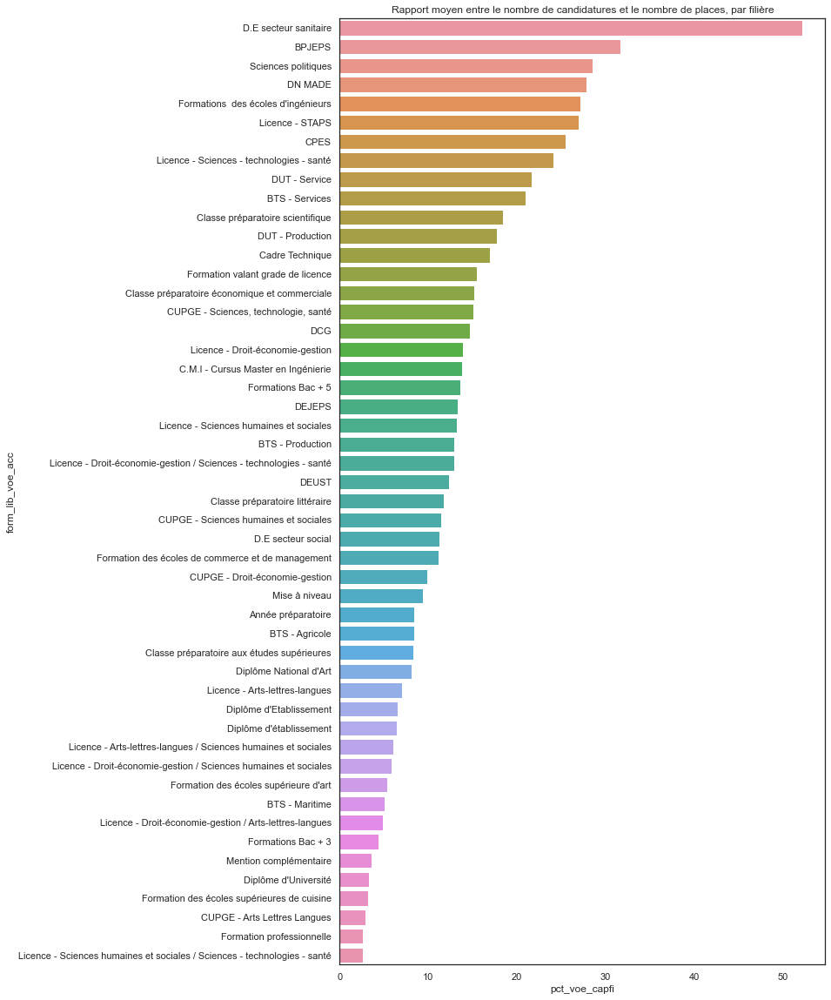

In [12]:
plt.figure(figsize=(10, 20))
plt.title("Rapport moyen entre le nombre de candidatures et le nombre de places, par filière")
plt.ylabel("#")
sns.barplot(x="pct_voe_capfi", y=filiere3.index, data=filiere3, ci=False);

In [13]:
# Visualisation du nombre de demandes selon la filière détaillée, total et femme
data_f_fil = data[['form_lib_voe_acc', 'voe_tot', 'voe_tot_f']].groupby(['form_lib_voe_acc']).sum().sort_values(by='voe_tot', ascending=False)
data_f_fil = data_f_fil.head(15)

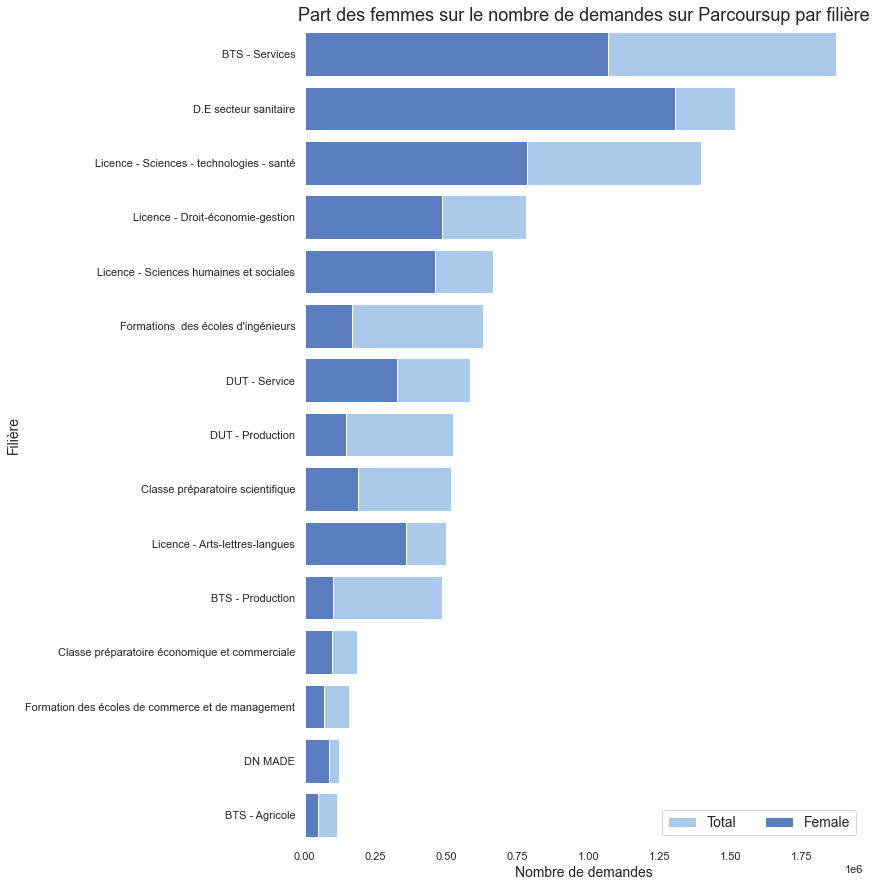

In [14]:
f, ax = plt.subplots(figsize=(10, 15))

sns.set_color_codes("pastel")
sns.barplot(x="voe_tot", y=data_f_fil.index, data=data_f_fil,
            label="Total", color="b")

sns.set_color_codes("muted")
sns.barplot(x="voe_tot_f", y=data_f_fil.index, data=data_f_fil,
            label="Female", color="b")

ax.legend(ncol=2, loc="lower right", frameon=True, fontsize=14)
ax.set_title("Part des femmes sur le nombre de demandes sur Parcoursup par filière", fontsize=18)
ax.set_xlabel('Nombre de demandes', fontsize=14)
ax.set_ylabel('Filière', fontsize=14)
sns.despine(left=True, bottom=True)

### Pourcentage d'acceptés par nombre de candidatures

In [18]:
# Pourcentage d'acceptés par nombre de candidatures.

import folium

# Preparation
df_main = pd.read_csv("fr-esr-parcoursup.csv", sep=";")
df_main["pct_acc_voe"] = df_main["acc_tot"]/df_main["voe_tot"] # % d'acceptés // nombre de candidats
df_main["pct_voe_capfi"] = df_main["voe_tot"]/df_main["capa_fin"] # nombre de candidats // capacité finale (pour une place combien de candidats)
df_main["pct_acc_voe"].replace([np.inf, -np.inf], np.nan, inplace=True)
df_main = df_main.dropna(subset=["pct_acc_voe"])
pop_data = df_main[['dep','pct_acc_voe']]
pop_data = pop_data.groupby(['dep'], as_index=False).mean()

coords = (48.7190835,2.4609723)
map2 = folium.Map(location=coords, tiles='OpenStreetMap', zoom_start=7) #tiles='OpenStreetMap'
# bins = list(pop_data["acc_tb"].quantile([0, 0.25, 0.5, 0.75, 1]))

folium.Choropleth(
    geo_data=geo_data,
    name='choropleth',
    data=pop_data,
    columns=['dep','pct_acc_voe'], # data key/value pair
    key_on='feature.properties.code', # corresponding layer in GeoJSON
    fill_color='BuPu',
    fill_opacity=0.7,
    line_opacity=0.2,
    # bins=bins,
    legend_name="Pourcentage acceptés par nombre de candidats"
).add_to(map2)


# map2.save(outfile='map.html')
map2

### Pourcentage d'acceptés avec mention TB par formation

In [19]:
# Pourcentage de mention TB des candidats par formations.
import folium, branca

df_main = pd.read_csv("fr-esr-parcoursup.csv", sep=";")
df_main = df_main[df_main['g_olocalisation_des_formations'].notna()]
df_main = df_main.dropna(subset=["pct_tb"])

#empty map
world_map= folium.Map(tiles="cartodbpositron")

cm = branca.colormap.LinearColormap(['blue', 'red'], vmin=min(df_main['pct_tb']), vmax=max(df_main['pct_tb']))
world_map.add_child(cm) # add this colormap on the display


for i in range(len(df_main)):
    coord = (df_main.iloc[i]['g_olocalisation_des_formations']).split(",")
    lat = coord[0]
    long = coord[1]
    folium.CircleMarker(        
        location = (lat, long),
        radius = (100-int(df_main.iloc[i]['pct_tb']))/100,
        # color = 'crimson',
        color=cm((int(df_main.iloc[i]['pct_tb']))),
        fill = True,
        fill_color=cm(((df_main.iloc[i]['pct_tb']))),
        # fill_color = 'crimson'
        legend_name='Pourcentage de mention TB des candidats par formations.'
    ).add_to(world_map)
    
world_map
# world_map.save(outfile='world_map2.html')


## Zoom sur 2 filières : BTS et Ecole d'ingénieur

### BTS

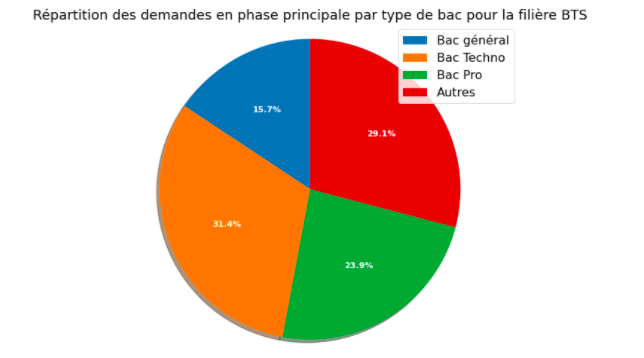

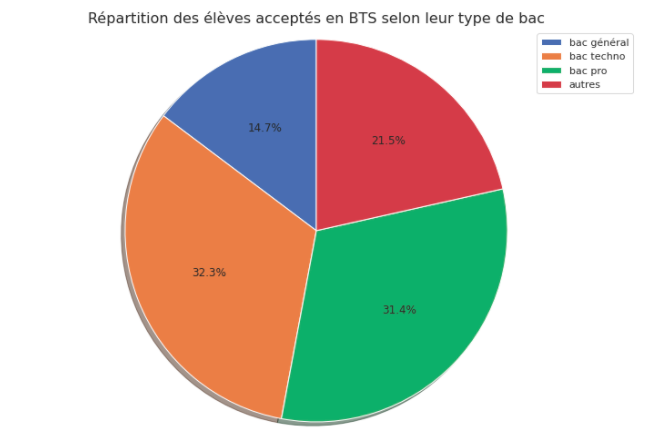

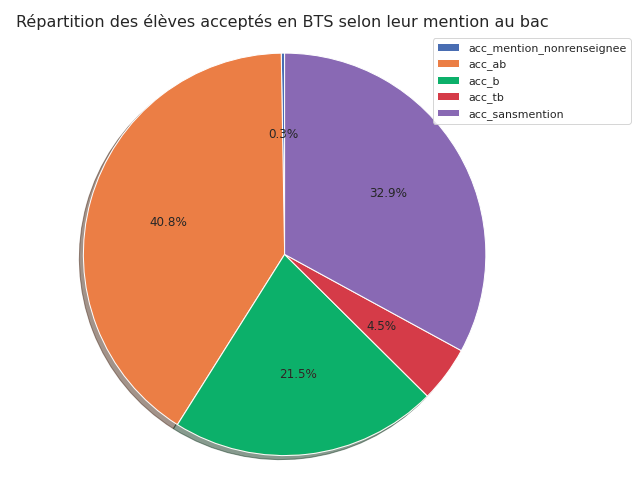

### Ecole d'ingénieur

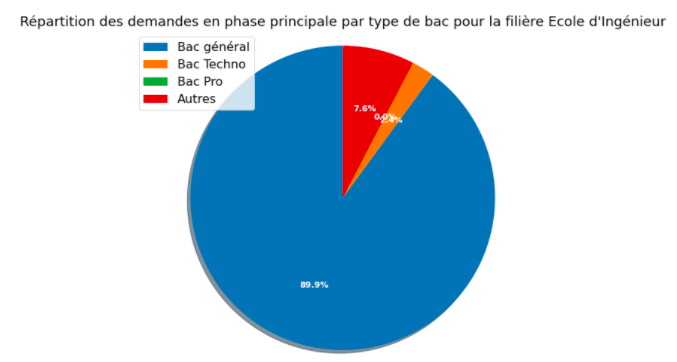

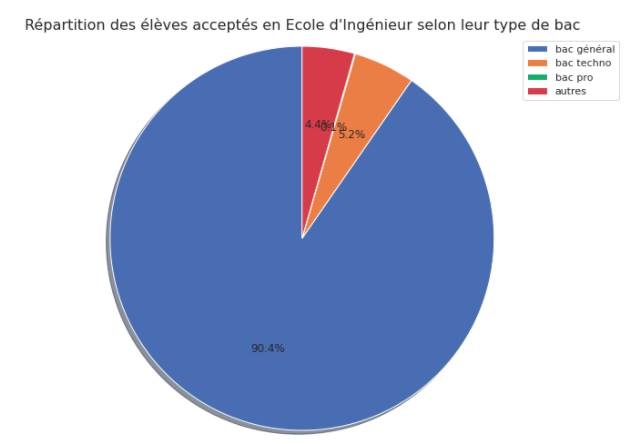

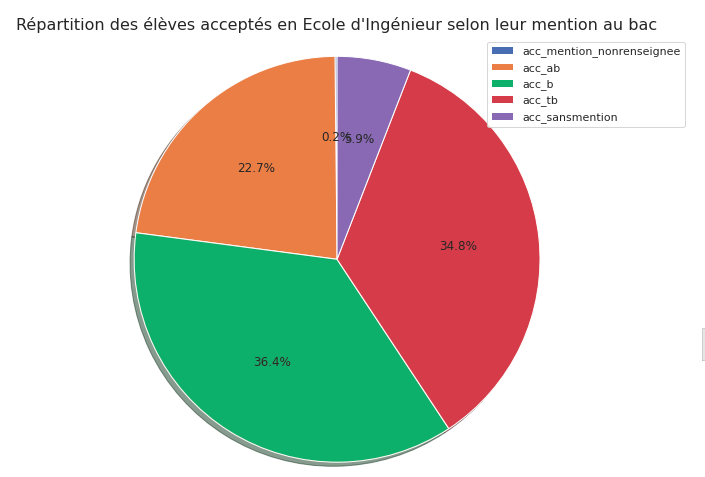

## Baseline

### Nettoyage du dataset basique pré Baseline

In [27]:
def df_info(df):
        len_df = len(df)
        all_columns = len(df.columns)
        all_nan = df.isna().sum().sum()
        list_of_numerics = df.select_dtypes(include = ['float','int']).columns
        print(f"""
        Longueur du dataset : {len_df} enregistrements
        Nombre de colonnes : {all_columns}
        """)
        echantillonColonnes = []
        for i in df.columns:
            listcolumn = str(list(df[i].head(5)))
            echantillonColonnes.append(listcolumn)
        obs = pd.DataFrame({'type': list(df.dtypes),
        'Echantillon': echantillonColonnes,
        "% de valeurs nulles":
        round(df.isna().sum() / len_df * 100, 2),
        'Nbr L dupliquées' : (df.duplicated()).sum(),
        'Nbr V unique' : df.nunique(),
        'Nbr Outliers' : df.apply(lambda x: sum(
                                 (x<(x.quantile(0.25) - 1.5 * (x.quantile(0.75)-x.quantile(0.25)))) |
                                 (x>(x.quantile(0.75) + 1.5 * (x.quantile(0.75)-x.quantile(0.25))))
                                 if x.name in list_of_numerics else ''))
        })
        return obs

def clean_dataset_for_baseline(data):
  # Colonnes catégorielles à drop pour la baseline afin d'éviter d'avoir trop de colonnes avec le OneHotEncoder
  cat_to_drop = data.loc[:, data.nunique() > 12].select_dtypes('object').columns
  # Colonnes voe à drop car colinéaires
  cols = data.columns
  col_voe_to_drop = [col for col in cols if 'voe' in col]
  # Drop colonnes inutiles
  data = data.drop(['session', 'select_form'], axis=1)
  data_base = data.drop(cat_to_drop, axis=1)
  # drop des colonnes voe liée a la target
  data_base = data_base.drop(col_voe_to_drop, axis=1, errors='ignore')
  # drop des colonnes avec plus de 50% de nulls
  df = df_info(data_base)
  df = df[df['% de valeurs nulles'] > 50.00]
  col_na_to_drop = df.index
  data_base = data_base.drop(col_na_to_drop, axis=1)
  return data_base

data_base = clean_dataset_for_baseline(data)


        Longueur du dataset : 12760 enregistrements
        Nombre de colonnes : 83
        


### Baseline

In [28]:
# Définition de la target et des features
y = data_base.target
X = data_base.drop(['target'], axis=1)

In [29]:
# Séparation en jeu de train et de test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

In [30]:
# Test du pipeline de base
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer()),
    ('scaler', MinMaxScaler())])

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='most_frequent')),
    ('encoder', OneHotEncoder(handle_unknown='ignore'))])

preprocessor = ColumnTransformer(transformers=[
    ('num', numeric_transformer, selector(dtype_exclude="object")),
    ('cat', categorical_transformer, selector(dtype_include="object"))],remainder='passthrough')

reg = Pipeline(steps=[('preprocessor', preprocessor),
                      ('regressor', LogisticRegression(max_iter=500))])

In [32]:
# Entrainement du modèle sur le jeu de train
reg.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   MinMaxScaler())]),
                                                  <sklearn.compose._column_transformer.make_column_selector object at 0x7ff12f87f370>),
                                                 ('cat',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encoder',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  <sklearn.compose._column_transformer.make_column_selector object at 0x7ff12f87f310>)])),
                ('regressor', LogisticRegression(max_iter=500))])

In [33]:
# Comparaison des scores train et test
print(reg.score(X_train, y_train), reg.score(X_test, y_test))

0.7655760188087775 0.7582288401253918


In [34]:
# Test cross validation
cross_validate(reg, X_train, y_train)

{'fit_time': array([2.06437993, 1.91448903, 3.06760192, 2.09790015, 2.12137985]),
 'score_time': array([0.01616573, 0.01466107, 0.02002716, 0.0137589 , 0.01559806]),
 'test_score': array([0.76640548, 0.74779628, 0.74779628, 0.74865262, 0.72562469])}

## Tests de différents modèles

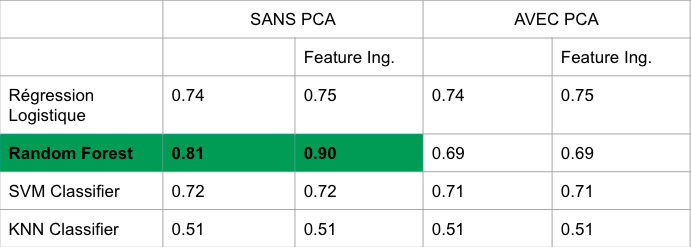

# Optimisation du modèle sélectionné : Random Forest

## Pré - processing

In [38]:
def data_cleaning():
 
    data = pd.read_csv( "fr-esr-parcoursup.csv",sep=";")
    
    # TARGET
    data['target']=data['voe_tot'].apply(lambda x: 0 if x < 200 else (1 if 200 <= x < 400 else (2 if 400 <= x < 900 else (3 if 900 <= x < 2000 else 4 ))))
    
    # NOUVELLES FEATURES
    data["pct_acc_cand"] = data["acc_tot"]/data["voe_tot"] # % d'acceptés // nombre de candidats
    data["pct_cand_capfi"] = data["voe_tot"]/data["capa_fin"] # nombre de candidats // capacité finale (pour une place combien de candidats)
    data["new_pct_acc_cand"] = data["pct_acc_cand"].apply(lambda x: 0 if x == np.inf else x)
    data = data.drop(columns=["pct_acc_cand"], axis=1)
    
    # SUPPRESSION COLONNES
    #cat
    cat_to_drop = ["select_form", "regr_forma", "lien_form_psup", "lib_comp_voe_ins", "g_olocalisation_des_formations", "cod_uai", "cod_aff_form", "g_ea_lib_vx", "detail_forma", "fil_lib_voe_acc", "dep", "lib_grp1", "lib_grp2", "lib_grp3", "lib_grp4", "lib_grp5", "region_etab_aff"]
    #num
    num = data.select_dtypes(include=np.number)
    num_to_drop = ["session", "ran_grp1"]
    #null
    null = (num.isnull().sum())/num.shape[0]
    null.sort_values(ascending=False)
    null_to_drop = null[null>0.5]
    null_to_drop = list(null_to_drop.index)
    #voe
    voe_cols = [col for col in data.columns if "voe" in col]
    #total
    cols_to_drop = num_to_drop + cat_to_drop + null_to_drop + voe_cols
    cols_to_drop = set(cols_to_drop)
    data = data.drop(columns=cols_to_drop, axis=1)
    
    # SUPPRESSION LIGNES
    rows_to_drop_one = list(data[data["capa_fin"].isnull()].index)
    rows_to_drop_two = list(data[data["pct_bp"].isnull()].index)
    rows_to_drop = rows_to_drop_one + rows_to_drop_two
    data = data.drop(index = rows_to_drop, axis = 1)
    
    return data

In [39]:
data_clean = data_cleaning()

In [40]:
X = data_clean.drop("target", axis=1)
y = data_clean.target

In [41]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

### Focus sur les outliers

L'ACP (Analyse en Composantes Principales) est sensible aux outliers.

Ainsi, un axe d’inertie peut n'être dû qu’à un petit groupe d’individus : ce sont les outliers. Un individu situé très loin de tous les autres a tendance à « attirer » dans sa direction l’un des axes d’inertie.

L'objectif est donc de détecter les outliers, puis de réaliser une ACP sur l'ensemble de ces outliers.

Ensuite l'analyse des premières composantes principales de cet ensemble permettra de déterminer si une feature contribue individuellement à expliquer fortement une composante principale.

Cela permettra de déterminer si ces individus nuisent au modèle. 

In [42]:
# Initialize the preprocessor

# Split numericals and categorical columns
numerical_columns = [colname for colname in X.columns if X[colname].dtype in ['int64', 'float64']]
categorical_columns = [colname for colname in X.columns if X[colname].dtype == "object"]
# Transformers
numerical_transformer = Pipeline(steps=[
    ('imputer',SimpleImputer()),
    ('scaler',MinMaxScaler())])
categorical_transformer = Pipeline(steps=[
    ('imputer',SimpleImputer(strategy='most_frequent')),
    ('onehot',OneHotEncoder(handle_unknown='ignore',sparse=False))])
# Preprocessor
preprocessor = ColumnTransformer(
    transformers=[
        ('numerical_transformer_constant', numerical_transformer, numerical_columns),
        ('categorical_transformer_mostfrequent', categorical_transformer, categorical_columns),])

In [43]:
# Preprocess 
X_scaled = pd.DataFrame(preprocessor.fit_transform(X))

In [44]:
# Choose an automatic detection of outliers.

from sklearn.neighbors import LocalOutlierFactor
from sklearn.svm import OneClassSVM
from sklearn.covariance import EllipticEnvelope
from sklearn.ensemble import IsolationForest
#lof = LocalOutlierFactor()   
#iso = IsolationForest(contamination=0.1)  
#ee = EllipticEnvelope(contamination=0.01) 
#ee = OneClassSVM(nu=0.01)

lof = LocalOutlierFactor() 
yhat = lof.fit_predict(X_scaled) # matrice of 1 or -1, where -1 is an outlier.
outliers = (np.where(yhat==-1))[0]
print(len(outliers), "rows detected as outliers.")

393 rows detected as outliers.


In [45]:
X_scaled.shape

(12601, 219)

In [46]:
# Initalize outliers ensemble.
X_outliers = X_scaled.iloc[outliers]
X_outliers.shape

(393, 219)

In [47]:
# Realize ACP on outliers ensemble

from sklearn import decomposition
n_comp = 3

# Calcul des composantes principales
pca = decomposition.PCA(n_components=n_comp)
X_train_PCA = pca.fit_transform(X_outliers)

print("la première composante principale explique:", int(round(pca.explained_variance_ratio_[0],2)*100),"% de la variance")
print("la seconde composante principale explique:", int(round(pca.explained_variance_ratio_[1],2)*100),"% de la variance")
print("la troisième composante principale explique:", int(round(pca.explained_variance_ratio_[2],2)*100),"% de la variance")
print("=="*35)
print("les", n_comp, "premières composantes principales expliquent:", int(round(pca.explained_variance_ratio_.sum(),2)*100),"% de la variance")

la première composante principale explique: 20 % de la variance
la seconde composante principale explique: 10 % de la variance
la troisième composante principale explique: 7 % de la variance
les 3 premières composantes principales expliquent: 37 % de la variance


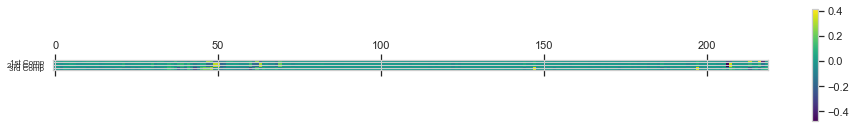

In [48]:
# heat-plot to see how the features mixed up to create the components.

plt.matshow(pca.components_,cmap='viridis')
plt.yticks([0,1,2],['1st Comp','2nd Comp','3rd Comp'],fontsize=8)
plt.colorbar()
# plt.xticks(range(len(df_main.columns)),df_main.columns,rotation=65,ha='left')
# plt.tight_layout()
plt.show()

Ici, aucune feature n'explique l'une des composantes principales du nuages d'outliers a plus de 40%.  
<b>Le nuage d'outliers ne devrait donc pas faire dévier le modèle.</b>

Effectivement, nous avons testé le modèle avec et sans les outliers : il n'y a pas eut de différence notable. 

Nous avons donc choisit de conserver ces individus. 

### Focus sur la PCA

In [49]:
# Preprocess 
X_train_scaled = pd.DataFrame(preprocessor.fit_transform(X_train))

In [50]:
# Realize ACP on X ensemble

from sklearn import decomposition
n_comp = 3

# Calcul des composantes principales
pca = decomposition.PCA(n_components=n_comp)
X_train_PCA = pca.fit_transform(X_train_scaled)

print("la première composante principale explique:", int(round(pca.explained_variance_ratio_[0],2)*100),"% de la variance")
print("la seconde composante principale explique:", int(round(pca.explained_variance_ratio_[1],2)*100),"% de la variance")
print("la troisième composante principale explique:", int(round(pca.explained_variance_ratio_[2],2)*100),"% de la variance")
print("=="*35)
print("les", n_comp, "premières composantes principales expliquent:", int(round(pca.explained_variance_ratio_.sum(),2)*100),"% de la variance")

la première composante principale explique: 20 % de la variance
la seconde composante principale explique: 8 % de la variance
la troisième composante principale explique: 6 % de la variance
les 3 premières composantes principales expliquent: 34 % de la variance


In [51]:
def pca1(xDF, yDF):
    tempDF = pd.DataFrame(data=xDF.loc[:,0:1], index=xDF.index)
    tempDF = pd.concat((tempDF,yDF), axis=1, join="inner")
    tempDF.columns = ["First Vector", "Second Vector", "Attractivité"]
    sns.lmplot(x="First Vector", y="Second Vector", hue="Attractivité", \
               data=tempDF, fit_reg=False)
    ax = plt.gca()
    ax.set_title("Séparation des observations en utilisant l'ACP (2 premiers vecteurs)")
    plt.plot([-1.5, 2.0], [0, 0], color='grey', ls='--')
    plt.plot([0, 0], [-1, 2.0], color='grey', ls='--')

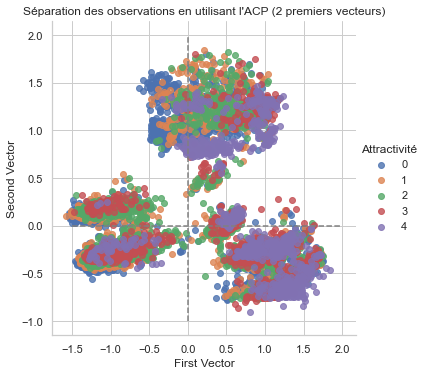

In [52]:
X_train_PCA = pd.DataFrame(data=X_train_PCA, index=X_train.index)

pca1(X_train_PCA, y_train)

In [53]:
def pca2(xDF, yDF):
    tempDF = pd.DataFrame(data=xDF.loc[:,1:2], index=xDF.index)
    tempDF = pd.concat((tempDF,yDF), axis=1, join="inner")
    tempDF.columns = ["Second Vector", "Third Vector", "Attractivité"]
    sns.lmplot(x="Second Vector", y="Third Vector", hue="Attractivité", \
               data=tempDF, fit_reg=False)
    ax = plt.gca()
    ax.set_title("Séparation des observations en utilisant l'ACP (vecteurs 2 et 3)")
    plt.plot([-1.5, 2.0], [0, 0], color='grey', ls='--')
    plt.plot([0, 0], [-1.5, 2.0], color='grey', ls='--')

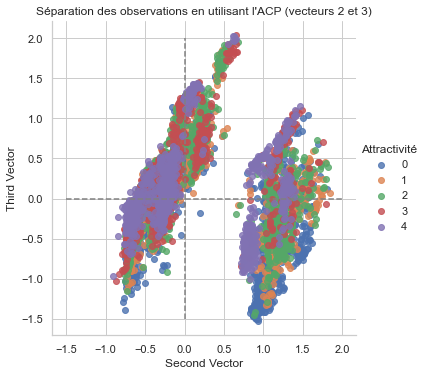

In [54]:
X_train_PCA = pd.DataFrame(data=X_train_PCA, index=X_train.index)

pca2(X_train_PCA, y_train)

A l'aide des deux premières composantes principales, des groupes d'invidus se distinguent nettement.   
Cela permet d'envisager qu'effectuer un <b>clustering</b> serait efficace.  
Cependant nous pouvons, d'ors et déjà supposer qu'il serait alors possible d'identifier les différentes fillières des formations (Master, Licences, etc...).  
Or, au sein de chacun de ces groupes, si on considère la distribution de notre 'target' d'attractivité représentée par le code couleur :  
- nous observons une répartition allant graduellement du quart nord-ouest, vers le quart sud-est.  

<b>Cette visualisation confirme donc qu'il est possible de créer un modèle utilisant les features que nous avons sélectionnées pour établir une note d'attractivité des formations.</b>

## Grid Search : optimisation du préprocessing et du modèle

In [55]:
# Définition de la target et des features
y = data_clean.target
X = data_clean.drop(['target'], axis=1)

In [56]:
# Séparation en jeu de train et de test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

In [57]:
# Pipeline GridSearch
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer()),
    ('scaler', MinMaxScaler())])

categorical_transformer = Pipeline(steps=[
    ('encoder', OneHotEncoder(handle_unknown='ignore'))])

preprocessor = ColumnTransformer(transformers=[
    ('num', numeric_transformer, selector(dtype_exclude="object")),
    ('cat', categorical_transformer, selector(dtype_include="object"))],remainder='passthrough')

rf = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', RandomForestClassifier(max_depth=15))])

In [60]:
# Paramètres à tester
param_grid = [
    {
        "preprocessor__num__imputer__strategy": ["mean", "median"],
        "preprocessor__num__scaler":[MinMaxScaler()],
        "classifier__n_estimators": [10, 100, 1000],
        "classifier__max_depth":[10,11,12,13]
    },
    {
        "preprocessor__num__imputer__strategy": ["mean", "median"],
        "preprocessor__num__scaler":[StandardScaler()],
        "classifier__n_estimators": [10, 100, 1000],
        "classifier__max_depth":[10,11,12,13]
    },
    {
        "preprocessor__num__imputer__strategy": ["mean", "median"],
        "preprocessor__num__scaler":[RobustScaler()],
        "classifier__n_estimators": [10, 100, 1000],
        "classifier__max_depth":[10,11,12,13]
    },
]

In [ ]:
# Grid Search
grid_search = GridSearchCV(rf, param_grid, cv=10, verbose=1,n_jobs=-1)
grid_search.fit(X_train, y_train)

In [ ]:
# Paramètres donnant le meilleur score
grid_search.best_params_

{'classifier__max_depth': 13,
 'classifier__n_estimators': 1000,
 'preprocessor__num__imputer__strategy': 'mean',
 'preprocessor__num__scaler': StandardScaler()}

# Modèle optimisé

In [61]:
# Pipeline final
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer()),
    ('scaler', StandardScaler())])

categorical_transformer = Pipeline(steps=[
    ('encoder', OneHotEncoder(handle_unknown='ignore'))])

preprocessor = ColumnTransformer(transformers=[
    ('num', numeric_transformer, selector(dtype_exclude="object")),
    ('cat', categorical_transformer, selector(dtype_include="object"))],remainder='passthrough')

rf_final = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', RandomForestClassifier(max_depth=8, n_estimators=1000))])

In [62]:
# Entrainement du modèle sur le jeu de train
rf_final.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  <sklearn.compose._column_transformer.make_column_selector object at 0x7ff131140f40>),
                                                 ('cat',
                                                  Pipeline(steps=[('encoder',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  <sklearn.compose._column_transformer.make_column_selector object at 0x7ff131140f70>)])),
                ('regressor',
                 RandomForestClassifier(max_depth=8, n_estimators=1000))])

In [63]:
# Comparaison des scores train et valid
print(rf_final.score(X_train, y_train),rf_final.score(X_test, y_test))

0.9050595238095238 0.8627528758429195


In [64]:
# Test cross validation
cross_validate(rf_final, X_train, y_train)

{'fit_time': array([16.32658386, 19.34922504, 15.16840506, 18.30806494, 19.87996507]),
 'score_time': array([0.49320912, 0.63123488, 0.69106913, 0.7855041 , 0.74323392]),
 'test_score': array([0.84126984, 0.84126984, 0.84722222, 0.8546627 , 0.85962302])}

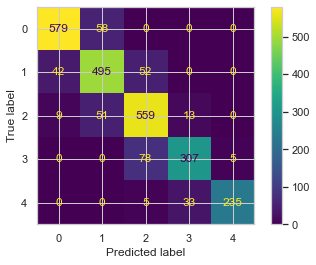

In [65]:
# Matrice de confusion
plot_confusion_matrix(rf_final, X_test, y_test) 

In [66]:
# Rapport de classification
y_pred = rf_final.predict(X_test)
print(classification_report(y_pred, y_test))

              precision    recall  f1-score   support

           0       0.91      0.92      0.91       630
           1       0.84      0.82      0.83       604
           2       0.88      0.81      0.84       694
           3       0.79      0.87      0.83       353
           4       0.86      0.98      0.92       240

    accuracy                           0.86      2521
   macro avg       0.86      0.88      0.87      2521
weighted avg       0.86      0.86      0.86      2521



[ 1008  2016  3024  4032  5040  6048  7056  8064  9072 10080]


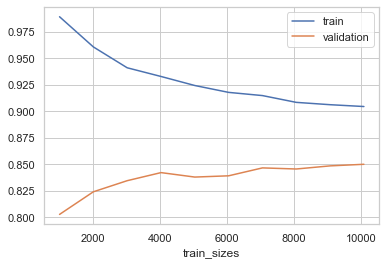

In [67]:
# Learning curve
N, train_score, val_score = learning_curve(rf_final, X, y,
                                           train_sizes=np.linspace(0.1, 1, 10), cv=5)

print(N)
plt.plot(N, train_score.mean(axis=1), label='train')
plt.plot(N, val_score.mean(axis=1), label='validation')
plt.xlabel('train_sizes')
plt.legend()

# Annexes - autres viz

In [20]:
# Répartition des élèves acceptés selon leur mention
mention = data[["fili", "acc_mention_nonrenseignee", "acc_ab", "acc_b", "acc_tb", "acc_sansmention"]]
mention = mention.groupby(by="fili").sum()
mention = mention.T
mention

fili,Autre formation,BTS,CPGE,DUT,EFTS,Ecole d'Ingénieur,Ecole de Commerce,IFSI,Licence,Licence_Las,PASS
acc_mention_nonrenseignee,115,285,88,59,1,30,76,15,1513,91,90
acc_ab,7190,43529,4332,20728,935,4199,4543,5317,65299,4952,6238
acc_b,6358,22948,11693,16154,683,6715,3388,5127,39127,3875,8668
acc_tb,6443,4799,21725,4056,198,6428,1349,1606,17094,2143,8642
acc_sansmention,6292,35153,736,8410,613,1088,3057,2206,76178,4155,2780


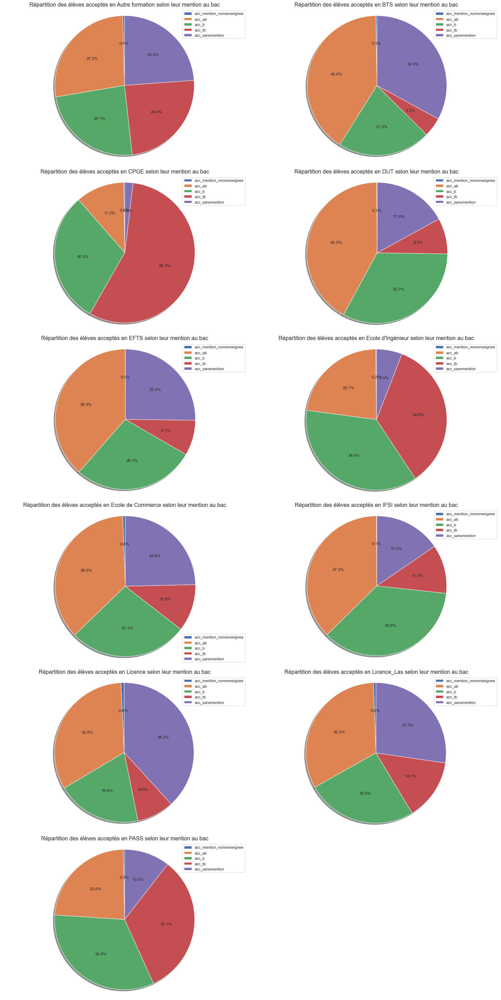

In [21]:
labels = mention.index
#explode = (0, 0.1, 0, 0) # pour faire un camembert qui est décalé
fig, axs = plt.subplots(6, 2, figsize=(20,40), constrained_layout=True)
for ax, fili in zip(axs.flat, mention.columns):
    ax.pie(mention[fili], autopct='%1.1f%%',
        shadow=True, startangle=90)
    ax.axis('equal')
    ax.legend(labels, loc="best")
    ax.set_title(f'Répartition des élèves acceptés en {fili} selon leur mention au bac', fontsize=16)
axs.flat[-1].set_visible(False)

In [ ]:
# répartition des élèves acceptés selon leur type de bac
bac = data[["fili", "acc_bg", "acc_bt", "acc_bp", "acc_at"]]
bac = bac.rename(columns = {"fili" : "fili", "acc_bg" : "bac général", "acc_bt" : "bac techno", "acc_bp" : "bac pro", "acc_at" : "autres"})
bac = bac.groupby(by="fili").sum()
bac = bac.T
bac

fili,Autre formation,BTS,CPGE,DUT,EFTS,Ecole d'Ingénieur,Ecole de Commerce,IFSI,Licence,Licence_Las,PASS
bac général,15733,20034,35708,31749,897,17449,11158,5525,162207,13784,25581
bac techno,5591,43947,2739,17044,908,997,1159,5641,26282,1125,649
bac pro,5075,42733,127,614,625,14,96,3105,10722,307,188
autres,10735,29208,2182,8656,4446,850,1872,11626,86193,5971,2423


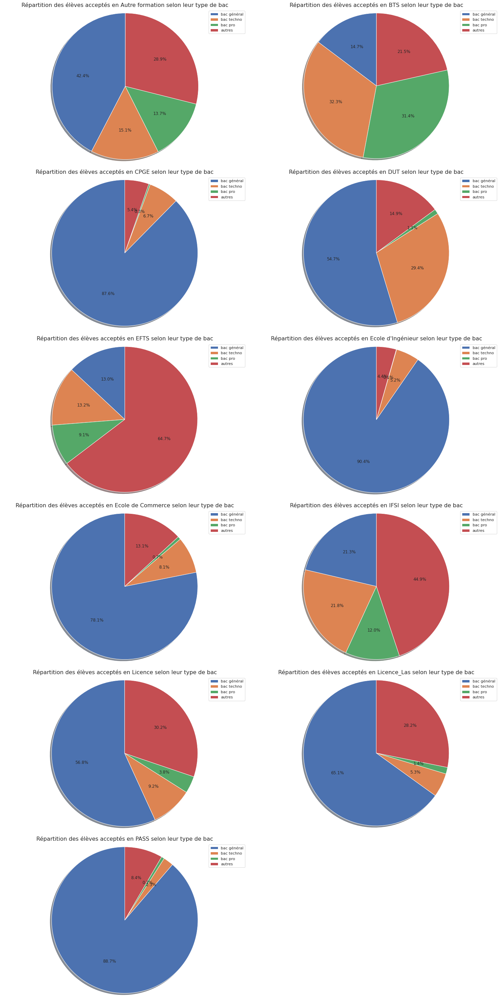

In [ ]:
labels = bac.index
#explode = (0, 0.1, 0, 0) # pour faire un camembert qui est décalé
fig, axs = plt.subplots(6, 2, figsize=(20,40), constrained_layout=True)
for ax, fili in zip(axs.flat, bac.columns):
    ax.pie(bac[fili], autopct='%1.1f%%',
        shadow=True, startangle=90)
    ax.axis('equal')
    ax.legend(labels, loc="best")
    ax.set_title(f'Répartition des élèves acceptés en {fili} selon leur type de bac', fontsize=16)
axs.flat[-1].set_visible(False)